

*   Thái Trần Khánh Nguyên
*   MSSV: 19520188
*   Bài tập so sánh hai ảnh





# Import libraries

In [ ]:
from google.colab import drive
import os
import cv2 as cv
from google.colab.patches import cv2_imshow
import numpy as np
import matplotlib.pyplot as plt
from scipy.spatial import distance
import random

# Read Images

In [ ]:
drive.mount('/gdrive')

Mounted at /gdrive


In [ ]:
dir_monhoc = '/gdrive/MyDrive/CS231.L22.KHCL'
dir_baitap = os.path.join(dir_monhoc, 'SoSanh2Anh')

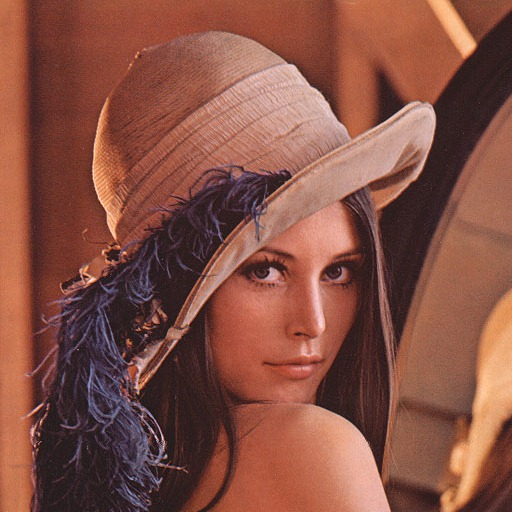

In [ ]:
path_filename = os.path.join(dir_baitap, 'lena.jpg')
img = cv.imread(path_filename)
cv2_imshow(img)

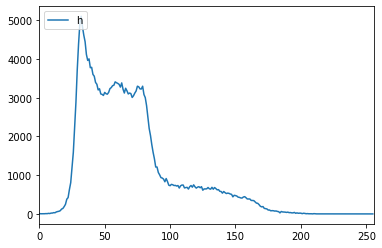

In [ ]:
# Solving Histogram
% hist = np.histogram(img.flatten(),256,[0,256])
hist = cv.calcHist([img],[0],None,[256],[0,256])

plt.plot(hist)
plt.xlim([0,256])
plt.legend(('histogram'),loc = 'upper left')
plt.show()

In [ ]:
# Hàm tính Histogram
def TinhHist(pathfilename):
    img = cv.imread(pathfilename,0)
    hist = cv.calcHist([img],[0],None,
                       [256],[0,256])
    size = img.shape[0]*img.shape[1]
    hist = hist / size
    return hist

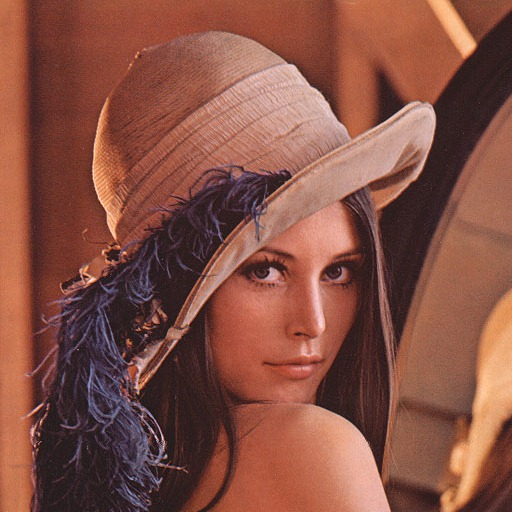

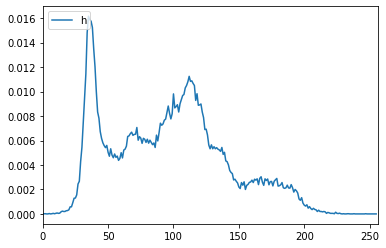

In [ ]:
# Show diagram
path_filename2 = os.path.join(dir_baitap, 'lena256.jpg')
img2 = cv.imread(path_filename2)
cv2_imshow(img)

plt.plot(TinhHist(path_filename2))
plt.xlim([0,256])
plt.legend(('histogram'),loc = 'upper left')
plt.show()

Tính khoảng cách giữa 2 ảnh lena.jpg và lena256.jpg

In [ ]:
d = distance.euclidean(TinhHist(path_filename), TinhHist(path_filename2))
print(d)
d2 = distance.cdist(TinhHist(path_filename), TinhHist(path_filename2), 'euclidean')
print(d2)

0.006519829878930243
[[0.00000000e+00 1.52587891e-05 1.52587891e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 1.52587891e-05 1.52587891e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 1.52587891e-05 1.52587891e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 1.52587891e-05 1.52587891e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 1.52587891e-05 1.52587891e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 1.52587891e-05 1.52587891e-05 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]]


# Comparing two images

In [ ]:
path_dataset = os.path.join(dir_baitap, 'Holiday50')
list_fn = os.listdir(path_dataset)
arr_histogram = []
for fn in list_fn:
  print(fn)
  arr_histogram.append(TinhHist(os.path.join(path_dataset, fn)))

In [ ]:
arr_histogram = np.array(arr_histogram)
arr_histogram.shape

(50, 256, 1)

1.   Chọn ngẫu nhiên 1 hình trong 50 hình
2.   Tính khoảng cách từ hình đó tới tất cả các hình còn lại



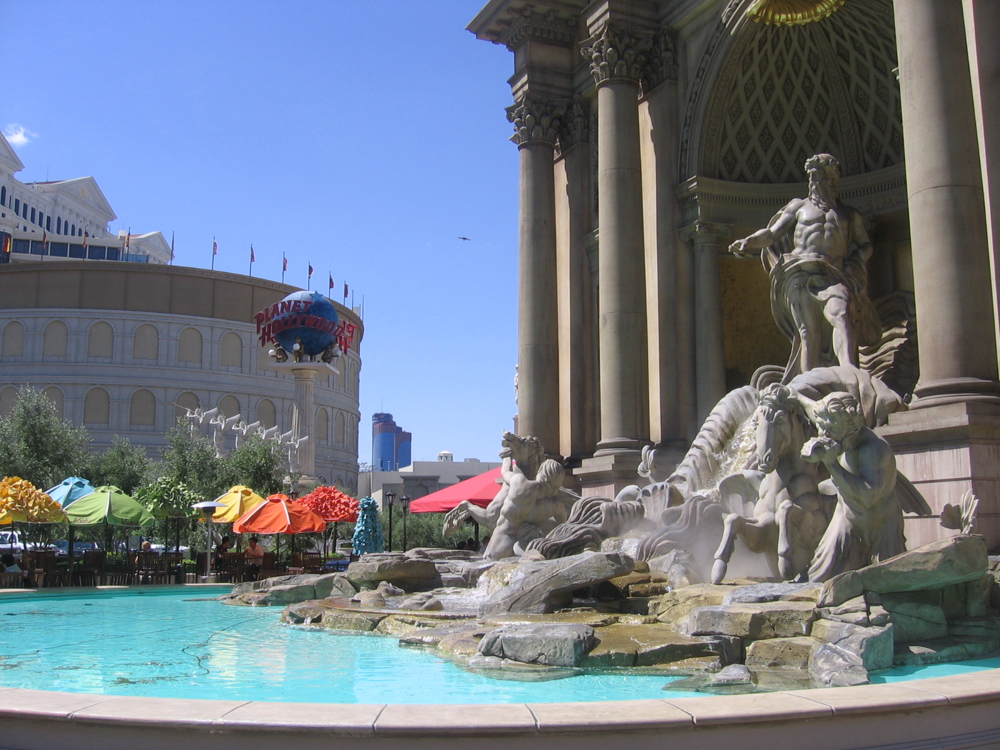

In [ ]:
index = 30
img = cv.imread(os.path.join(path_dataset, list_fn[index]))
cv2_imshow(img)

In [ ]:
ans = []
ans2 = []
for i in range(50):
  d = distance.euclidean(arr_histogram[i], arr_histogram[index])
  d2 = distance.cdist(arr_histogram[i], arr_histogram[index], 'euclidean')
  ans.append([d, list_fn[i]] )
  ans2.append([d2, list_fn[i] ])

ans = sorted(ans)
for i in range(5):
  print(ans[i])
                           

[0.0, '149302.jpg']
[70046.515625, '149602.jpg']
[73135.1640625, '149301.jpg']
[94509.3359375, '149401.jpg']
[113847.953125, '149601.jpg']


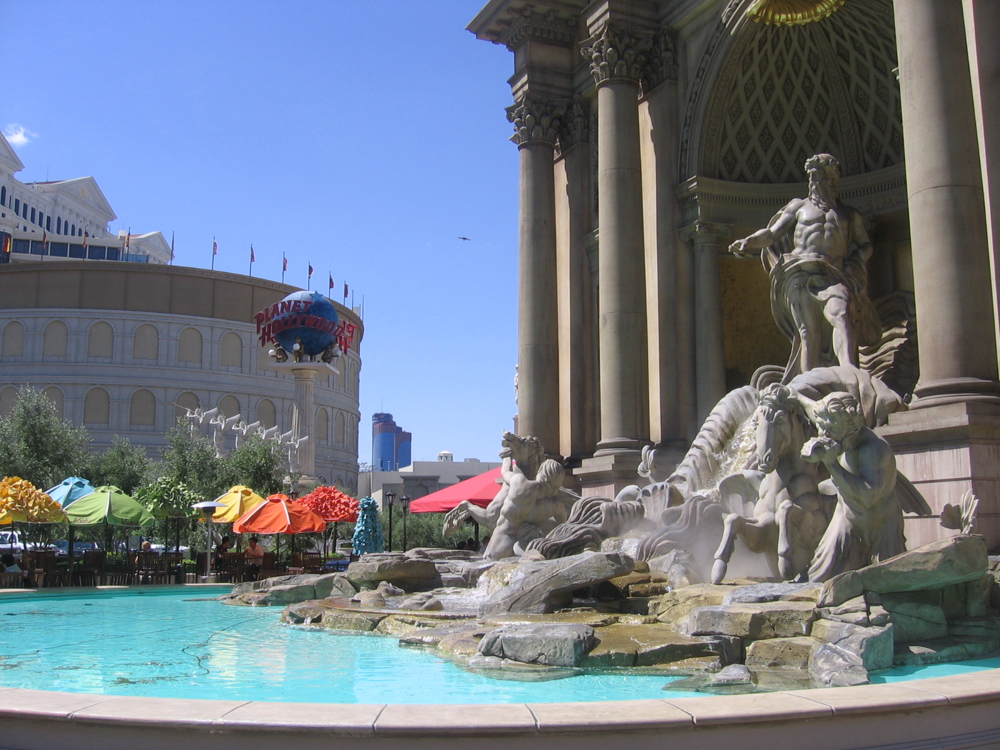

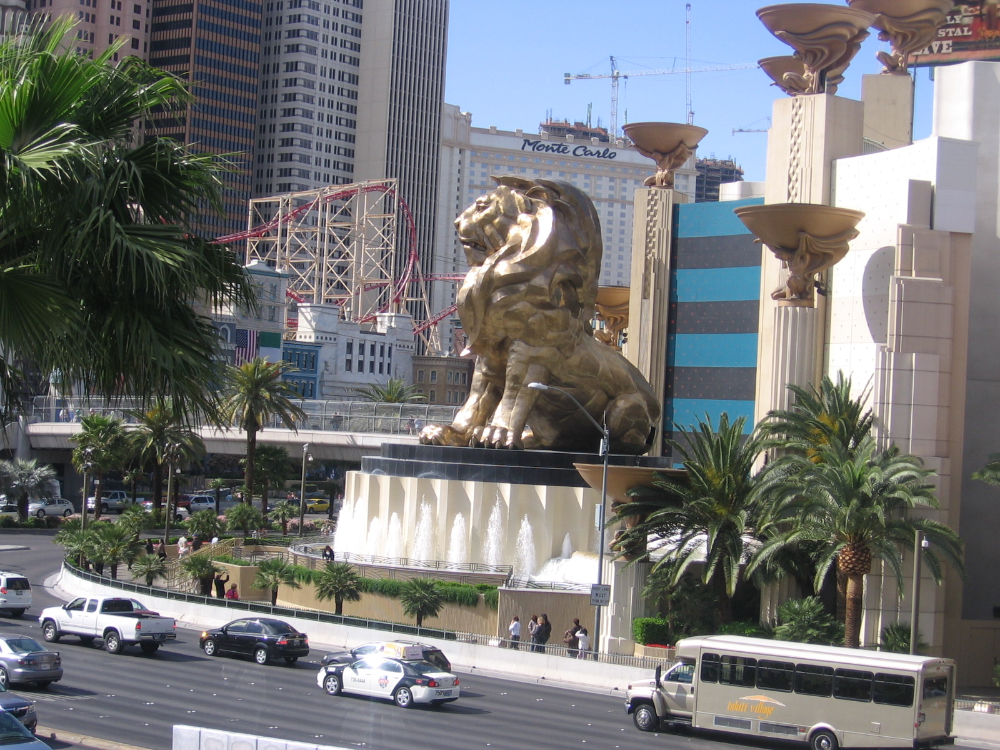

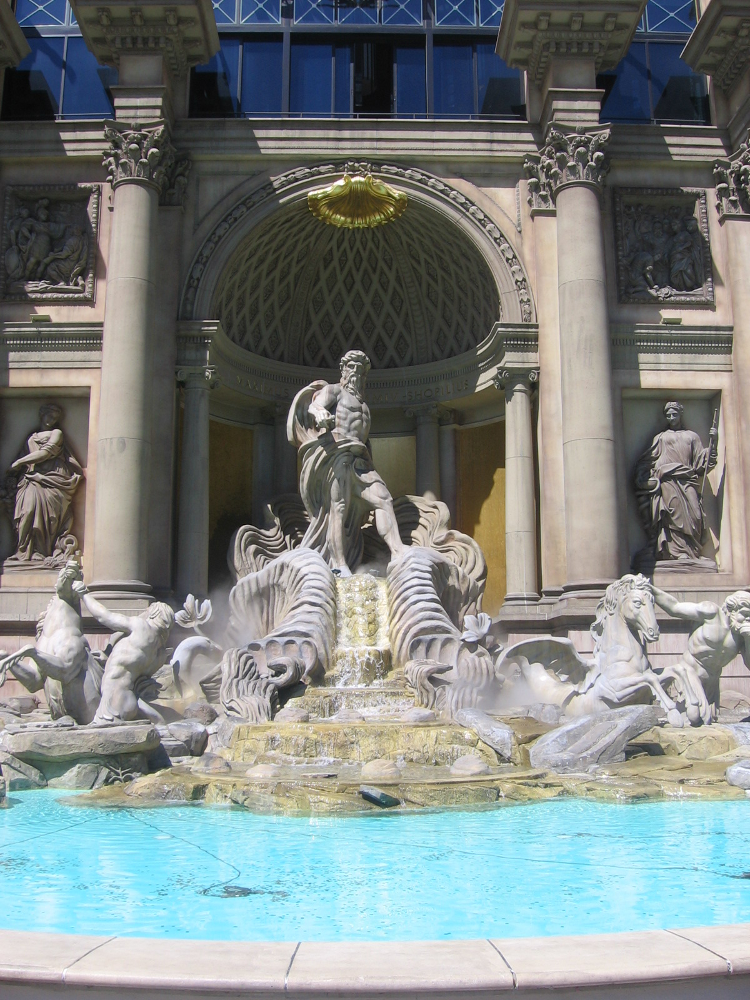

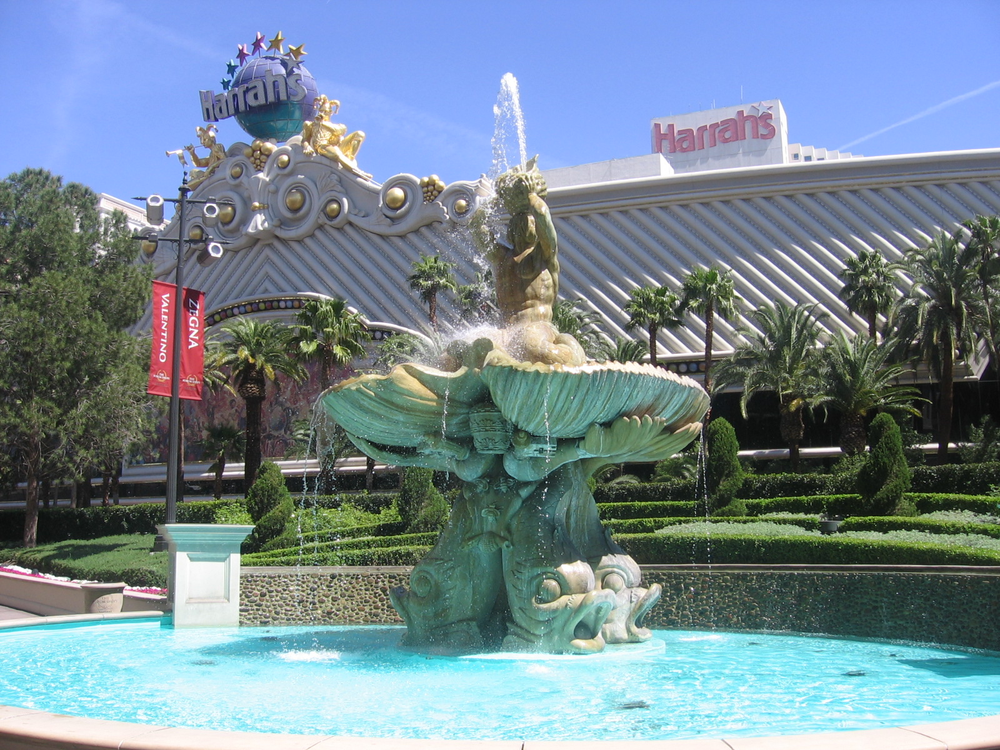

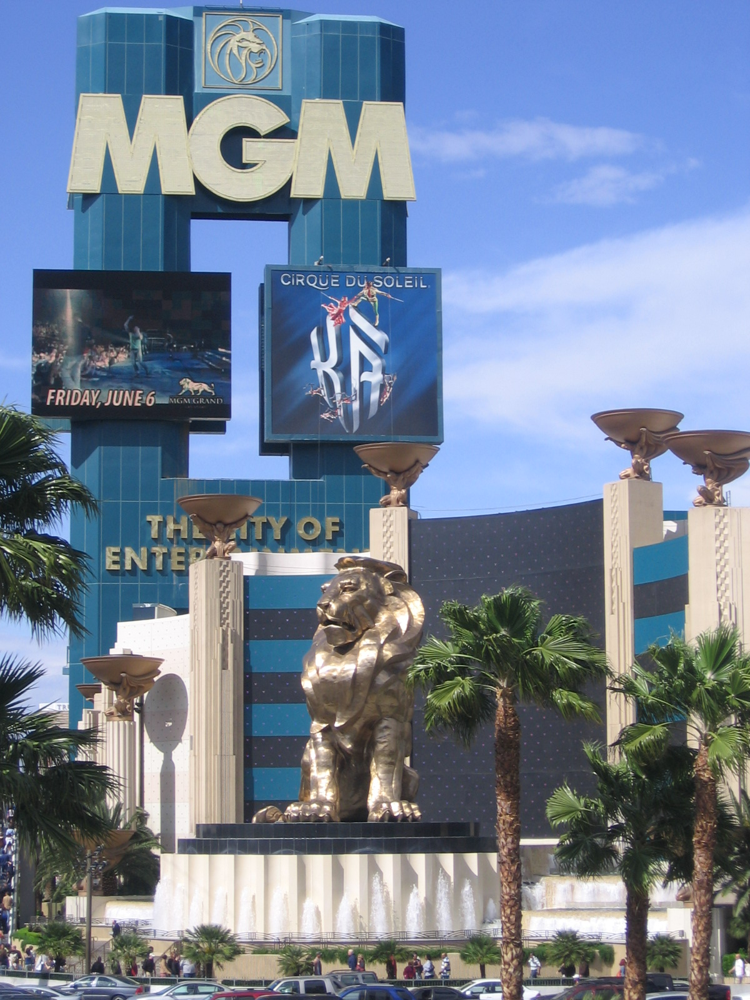

In [ ]:
for i in range(5):
  img = cv.imread(os.path.join(path_dataset, ans[i][1]))
  cv2_imshow(img)